<a href="https://colab.research.google.com/github/12Brainer/aa-cafe-hojas-clasificacion/blob/main/quiz2brainer_con_ViT_(3).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Ejemplo de procesamiento

In [ ]:
#Instalación de bibliotecas
!pip install -U transformers
!pip install transformers evaluate
!pip install accelerate datasets -U
!pip install huggingface_hub

In [ ]:
#iniciar sesión en Hugging Face

from huggingface_hub import notebook_login

notebook_login()

. Cargar el dataset desde Hugging Face dentro del cuaderno y visualizar una muestra
 representativa de imágenes con sus etiquetas (2 puntos).


In [ ]:
from datasets import load_dataset

dataset = load_dataset("brainer-fp66/coffee-leaf-diseases")

Repo card metadata block was not found. Setting CardData to empty.


In [ ]:
#Estructura del dataset

dataset

DatasetDict({
    train: Dataset({
        features: ['image', 'label'],
        num_rows: 1511
    })
    validation: Dataset({
        features: ['image', 'label'],
        num_rows: 323
    })
    test: Dataset({
        features: ['image', 'label'],
        num_rows: 330
    })
})

In [ ]:
#Categorías

labels = dataset['train'].features['label']

print(f"Labels: \n {labels.names}")

Labels: 
 ['Healthy', 'Miner', 'Phoma', 'Red Spider Mite', 'Rust']


#### Ejemplo de imagen

In [ ]:
example1 = dataset['train'][1000]
example1_label = labels.int2str(example1['label'])

Categoría: Phoma


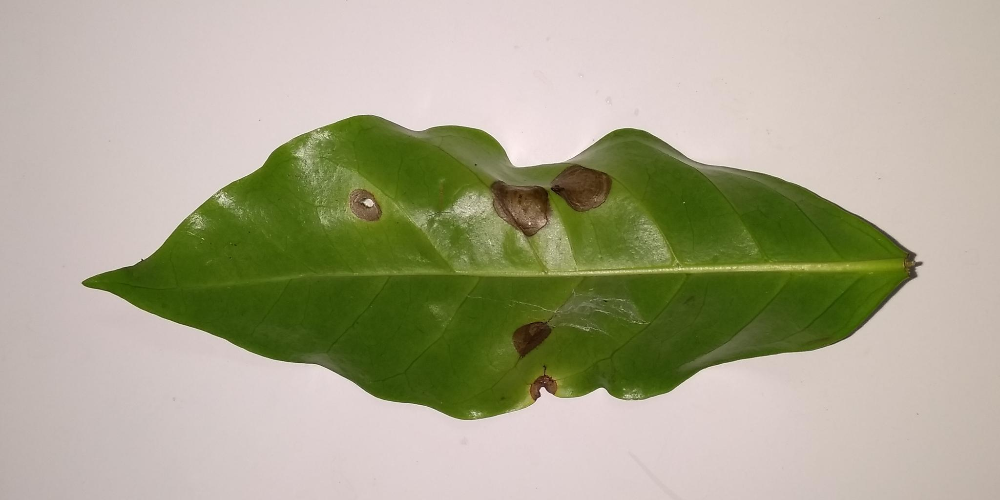

In [ ]:
print(f"Categoría: {example1_label}")
example1['image']

## ViT for image classification
7. Cargar los pesos del modelo ViT preentrenado y el procesador para preparar las
 imágenes.




URL: https://huggingface.co/docs/transformers/en/model_doc/vit

In [ ]:
#Cargar modelo

from transformers import ViTImageProcessor
from accelerate import Accelerator

model_name = 'google/vit-base-patch16-224-in21k'
processor = ViTImageProcessor.from_pretrained(model_name)

In [ ]:
#Procesamiento de ViT

processor

ViTImageProcessor {
  "do_convert_rgb": null,
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "ViTImageProcessor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

In [ ]:
processor(example1['image'], return_tensors='pt')

{'pixel_values': tensor([[[[0.4588, 0.4667, 0.4745,  ..., 0.5137, 0.4980, 0.4902],
          [0.4588, 0.4667, 0.4745,  ..., 0.5137, 0.4980, 0.5059],
          [0.4667, 0.4667, 0.4745,  ..., 0.5137, 0.4980, 0.4980],
          ...,
          [0.4275, 0.4353, 0.4431,  ..., 0.4824, 0.4824, 0.4745],
          [0.4275, 0.4431, 0.4510,  ..., 0.4902, 0.4745, 0.4745],
          [0.4275, 0.4275, 0.4431,  ..., 0.4745, 0.4745, 0.4745]],

         [[0.3725, 0.3804, 0.3882,  ..., 0.4353, 0.4196, 0.4118],
          [0.3725, 0.3804, 0.3882,  ..., 0.4353, 0.4196, 0.4275],
          [0.3804, 0.3804, 0.3882,  ..., 0.4353, 0.4196, 0.4196],
          ...,
          [0.3412, 0.3490, 0.3569,  ..., 0.3804, 0.3804, 0.3725],
          [0.3412, 0.3569, 0.3647,  ..., 0.3882, 0.3725, 0.3725],
          [0.3412, 0.3412, 0.3569,  ..., 0.3725, 0.3725, 0.3725]],

         [[0.3412, 0.3490, 0.3569,  ..., 0.3412, 0.3255, 0.3176],
          [0.3412, 0.3490, 0.3569,  ..., 0.3412, 0.3255, 0.3333],
          [0.3490, 0.3490

8.Definir los hiperparámetros de afinamiento. Incluir al menos tasa de aprendizaje, tamaño
 de lote, número de épocas, estrategia de evaluación, criterio de parada y política de
 guardado del mejor modelo (5 puntos).

In [ ]:
#Procesamiento del dataset

def transform(example_batch):
  inputs = processor([x for x in example_batch['image']], return_tensors='pt')
  inputs['label'] = example_batch['label']
  return inputs

In [ ]:
prepared_dataset = dataset.with_transform(transform)

In [ ]:
prepared_dataset['train'][0]

{'pixel_values': tensor([[[0.5451, 0.5529, 0.5529,  ..., 0.2314, 0.2157, 0.2078],
          [0.5373, 0.5451, 0.5451,  ..., 0.2314, 0.2235, 0.2157],
          [0.5373, 0.5451, 0.5608,  ..., 0.2314, 0.2235, 0.2078],
          ...,
          [0.4353, 0.4510, 0.4745,  ..., 0.2000, 0.1843, 0.1843],
          [0.4353, 0.4510, 0.4667,  ..., 0.1922, 0.1843, 0.1922],
          [0.4353, 0.4510, 0.4667,  ..., 0.1922, 0.2000, 0.1922]],
 
         [[0.5216, 0.5294, 0.5294,  ..., 0.2078, 0.1922, 0.1843],
          [0.5137, 0.5216, 0.5216,  ..., 0.2078, 0.2000, 0.1922],
          [0.5137, 0.5216, 0.5373,  ..., 0.2078, 0.2000, 0.1843],
          ...,
          [0.4275, 0.4353, 0.4431,  ..., 0.1765, 0.1529, 0.1529],
          [0.4275, 0.4353, 0.4431,  ..., 0.1686, 0.1529, 0.1608],
          [0.4275, 0.4431, 0.4353,  ..., 0.1686, 0.1686, 0.1608]],
 
         [[0.4824, 0.4902, 0.4902,  ..., 0.1686, 0.1529, 0.1451],
          [0.4745, 0.4824, 0.4824,  ..., 0.1686, 0.1608, 0.1529],
          [0.4745, 0.482

In [ ]:
#Tensor de imágenes

import torch

def collate_fn(batch):
    return {
        'pixel_values': torch.stack([x['pixel_values'] for x in batch]),
        'labels': torch.tensor([x['label'] for x in batch])
    }

In [ ]:
#Métricas a evaluar

import numpy as np
import evaluate

acc = evaluate.load("accuracy")
f1 = evaluate.load("f1")

def compute_metrics(p):
  preds = np.argmax(p.predictions, axis=1)
  acc_result = acc.compute(predictions=preds, references=p.label_ids)
  f1_result = f1.compute(predictions=preds, references=p.label_ids, average='macro')

  return {
      'accuracy': acc_result['accuracy'],
      'f1': f1_result['f1']
  }

In [ ]:
from transformers import ViTForImageClassification

labels = dataset['train'].features['label'].names

model = ViTForImageClassification.from_pretrained(
    model_name,
    num_labels=len(labels),
    id2label={str(i): c for i, c in enumerate(labels)},
    label2id={c: str(i) for i, c in enumerate(labels)}
)

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


9. Afinar el modelo con los datos de entrenamiento y validación. Publicar el mejor modelo en
 su cuenta de Hugging Face e incluir en la tarjeta del modelo los resultados de
 entrenamiento y un breve resumen metodológico (5 puntos).

In [ ]:
#Parámetros de entrenamiento

from transformers import TrainingArguments

training_args = TrainingArguments(
  output_dir="./vit-coffee-leaf-diseases",
  per_device_train_batch_size=8,
  eval_strategy="steps",
  num_train_epochs=1,
  fp16=True,
  save_steps=100,
  eval_steps=100,
  logging_steps=10,
  learning_rate=2e-4,
  save_total_limit=2,
  remove_unused_columns=False,
  push_to_hub=True,
  report_to='tensorboard',
  load_best_model_at_end=True,

)

In [ ]:
from transformers import Trainer

trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=collate_fn,
    compute_metrics=compute_metrics,
    train_dataset=prepared_dataset["train"],
    eval_dataset=prepared_dataset["validation"],
    processing_class=processor,
)

10. Evaluar el modelo en el conjunto de pruebas con Accuracy, Precision, Recall y F1. Incluir
 matriz de confusión y reporte de clasificación (3 puntos).

In [ ]:
#Entrenamiento

train_results = trainer.train()
trainer.save_model()
trainer.log_metrics("train", train_results.metrics)
trainer.save_metrics("train", train_results.metrics)
trainer.save_state()

Step,Training Loss,Validation Loss,Accuracy,F1
100,0.237300,0.336765,0.888545,0.864457


Processing Files (0 / 0)                : |          |  0.00B /  0.00B            

New Data Upload                         : |          |  0.00B /  0.00B            

  ...fee-leaf-diseases/training_args.bin: 100%|##########| 5.37kB / 5.37kB            

  ...ents.1755442378.fc22637871c3.4329.0: 100%|##########| 9.58kB / 9.58kB            

  ...ents.1755442627.fc22637871c3.4329.1: 100%|##########|   457B /   457B            

  ...ents.1755445991.fc22637871c3.4329.2: 100%|##########| 9.58kB / 9.58kB            

  ...ents.1755446210.fc22637871c3.4329.3: 100%|##########|   457B /   457B            

  ...ents.1755447774.fc22637871c3.4329.4: 100%|##########| 9.58kB / 9.58kB            

  ...fee-leaf-diseases/model.safetensors:   7%|7         | 25.1MB /  343MB            

***** train metrics *****
  epoch                    =         1.0
  total_flos               = 109051861GF
  train_loss               =      0.4252
  train_runtime            =  0:03:06.54
  train_samples_per_second =         8.1
  train_steps_per_second   =       1.013


In [ ]:
#Resultado de las métricas

metrics = trainer.evaluate(prepared_dataset['validation'])
trainer.log_metrics("eval", metrics)
trainer.save_metrics("eval", metrics)

***** eval metrics *****
  epoch                   =        1.0
  eval_accuracy           =     0.8885
  eval_f1                 =     0.8645
  eval_loss               =     0.3368
  eval_runtime            = 0:00:20.32
  eval_samples_per_second =     15.894
  eval_steps_per_second   =      2.017


In [ ]:
#Subir a Hugging Face el modelo entrenado

kwargs = {
    "finetuned_from": model.config._name_or_path,
    "tasks": "image-classification",
    "dataset": 'coffee-leaf-diseases',
    "tags": ['image-classification'],
}

if training_args.push_to_hub:
    trainer.push_to_hub('🍻 cheers', **kwargs)
else:
    trainer.create_model_card(**kwargs)

Processing Files (0 / 0)                : |          |  0.00B /  0.00B            

New Data Upload                         : |          |  0.00B /  0.00B            

  ...ents.1755442627.fc22637871c3.4329.1: 100%|##########|   457B /   457B            

  ...ents.1755442378.fc22637871c3.4329.0: 100%|##########| 9.58kB / 9.58kB            

  ...ents.1755445991.fc22637871c3.4329.2: 100%|##########| 9.58kB / 9.58kB            

  ...ents.1755446210.fc22637871c3.4329.3: 100%|##########|   457B /   457B            

  ...ents.1755447774.fc22637871c3.4329.4: 100%|##########| 9.58kB / 9.58kB            

  ...fee-leaf-diseases/model.safetensors:  12%|#1        | 40.9MB /  343MB            

  ...ents.1755448124.fc22637871c3.4329.5:   1%|1         |  6.00B /   457B            

  ...fee-leaf-diseases/training_args.bin:   1%|1         |  73.0B / 5.37kB            

# Pruebas básicas

 11. Realizar pruebas de inferencia con al menos tres imágenes del conjunto de pruebas y
 mostrar las predicciones con sus probabilidades (1 punto).

In [ ]:
from transformers import pipeline

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def predict_class(image):
  pipe = pipeline("image-classification", model="brainer-fp66/vit-coffee-leaf-diseases", device = device, feature_extractor="vit_feature_extractor")
  preds = pipe(image)
  return preds

In [ ]:
print(f"Categorías: {dataset['train'].features['label'].names}")

Categorías: ['Healthy', 'Miner', 'Phoma', 'Red Spider Mite', 'Rust']


In [ ]:
#Imágenes para prueba

dataset['test']

Dataset({
    features: ['image', 'label'],
    num_rows: 330
})

###Prueba 1

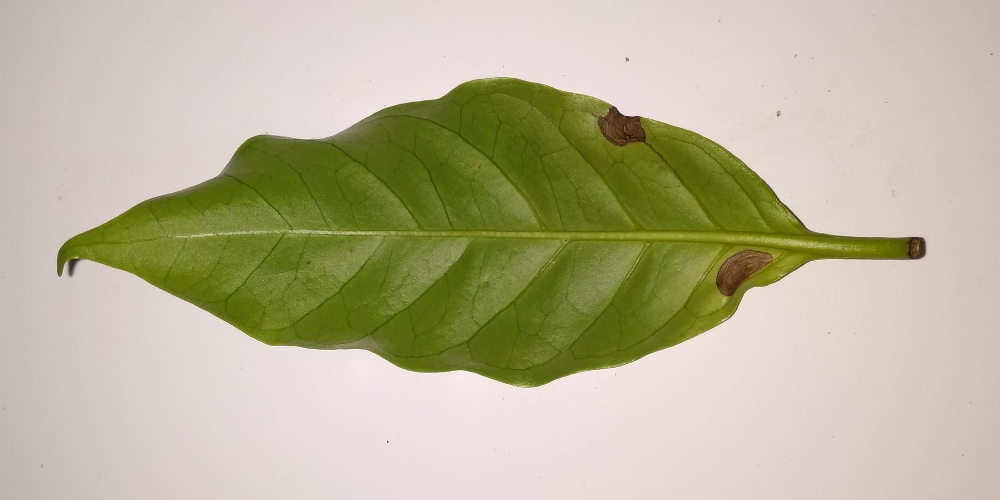

In [ ]:
#Imagen

ex = dataset['test'][210]
label = ex['label']
image = ex['image']

image

In [ ]:
#predicción

print(f"Real: {dataset['test'].features['label'].names[label]}")
print(f"\nPredicción: {predict_class(image)}")

Real: Phoma


Device set to use cuda



Predicción: [{'label': 'Miner', 'score': 0.21419960260391235}, {'label': 'Healthy', 'score': 0.2034916877746582}, {'label': 'Rust', 'score': 0.1983368992805481}, {'label': 'Phoma', 'score': 0.1920899599790573}, {'label': 'Red Spider Mite', 'score': 0.19188189506530762}]


###Prueba 2

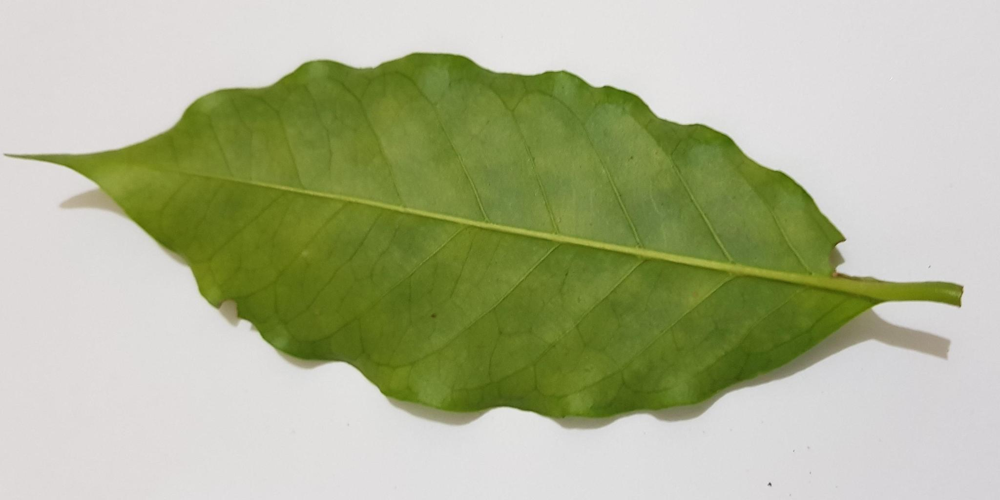

In [ ]:
#Imagen

ex2 = dataset['test'][0]
label2 = ex2['label']
image2 = ex2['image']

image2

In [ ]:
#Resultado

print(f"Real: {dataset['test'].features['label'].names[label2]}")
print(f"Predicción: {predict_class(image2)}")

Real: Healthy


Device set to use cuda


Predicción: [{'label': 'Rust', 'score': 0.2234601378440857}, {'label': 'Healthy', 'score': 0.20829983055591583}, {'label': 'Phoma', 'score': 0.20340675115585327}, {'label': 'Miner', 'score': 0.1942620426416397}, {'label': 'Red Spider Mite', 'score': 0.1705712378025055}]


###Prueba 3

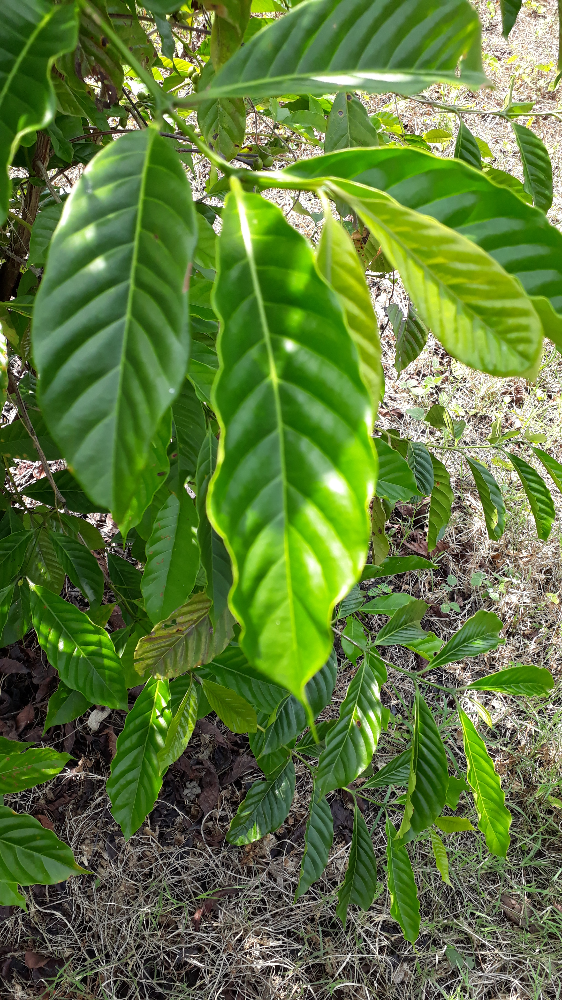

In [ ]:
#Imagen

ex3 = dataset['test'][45]
label3 = ex3['label']
image3 = ex3['image']

image3

In [ ]:
#Predicción

print(f"Real: {dataset['test'].features['label'].names[label3]}")
print(f"\nPredicción: {predict_class(image3)}")

Real: Healthy


Device set to use cuda



Predicción: [{'label': 'Phoma', 'score': 0.21361000835895538}, {'label': 'Healthy', 'score': 0.21212519705295563}, {'label': 'Miner', 'score': 0.20792070031166077}, {'label': 'Red Spider Mite', 'score': 0.20195651054382324}, {'label': 'Rust', 'score': 0.16438759863376617}]


###Prueba 4

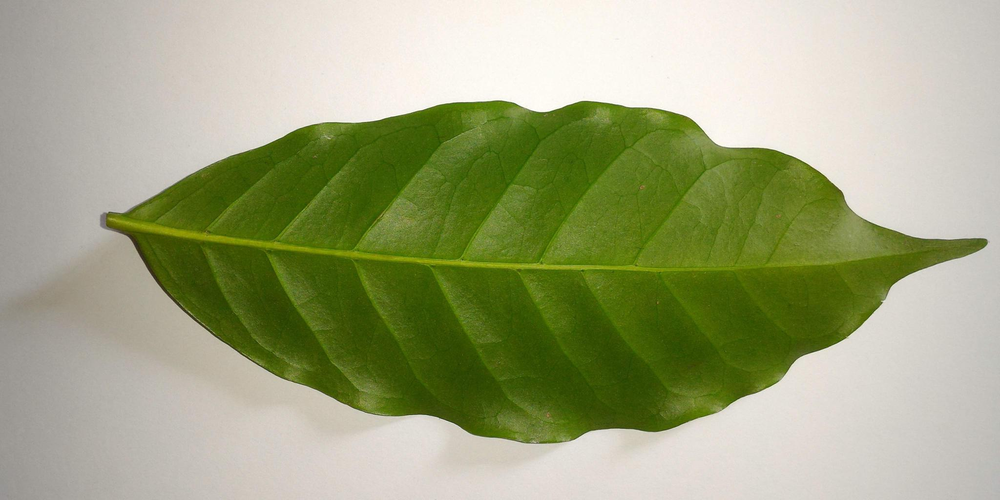

In [ ]:
#Imagen

ex4 = dataset['test'][23]
label4 = ex4['label']
image4 = ex4['image']

image4

In [ ]:
#Predicción

print(f"Real: {dataset['test'].features['label'].names[label4]}")
print(f"\nPredicción: {predict_class(image4)}")

Real: Healthy


Device set to use cuda



Predicción: [{'label': 'Rust', 'score': 0.22490344941616058}, {'label': 'Healthy', 'score': 0.20676296949386597}, {'label': 'Red Spider Mite', 'score': 0.19333025813102722}, {'label': 'Miner', 'score': 0.1889118105173111}, {'label': 'Phoma', 'score': 0.1860915720462799}]


 12. Presentar al menos tres conclusiones basadas en la evidencia obtenida (2 puntos).

 Ejercicio 2:  Seleccione alguno de los siguientes artículos para realizar una explicación en la
 clase.

El modelo no logra distinguir claramente entre hojas sanas y con enfermedades, ya que en las pruebas de inferencia asigna probabilidades similares a varias clases. Esto evidencia que el entrenamiento necesita más ajustes o más datos balanceados.

Existe confusión entre categorías con síntomas visualmente similares, como Rust, Phoma y Miner, lo que sugiere que el modelo requiere un preprocesamiento más robusto (aumento de datos, segmentación de hojas) para mejorar la discriminación.

Las métricas obtenidas en las predicciones individuales reflejan una baja confianza (≈20%), lo que indica que el modelo no está bien calibrado. Se recomienda extender el número de épocas, probar con tasas de aprendizaje diferentes y usar técnicas de regularización.

 13. Documentar todas las secciones, incluyendo decisiones de diseño y posibles limitaciones
 (2 puntos).

Una limitación del experimento fue la baja cantidad de imágenes para algunas clases, lo que generó confusión en las predicciones. Además, debido al tiempo de entrenamiento disponible, solo se corrió el modelo por 1 época

 14. Incluir referencias en formato IEEE al final del documento (1 punto).

## Referencias

[1] M. A. Mora, *Reconocimiento de patrones en imágenes*, Instituto Tecnológico de Costa Rica, 2025. Material de clase.  

[2] M. A. Mora, *Transformers Intro V5*, Instituto Tecnológico de Costa Rica, 2025. Material de clase.  

[3] M. A. Mora, *Ejemplo ENA24 con ViT*, Instituto Tecnológico de Costa Rica, 2025. Notebook de clase.  

[4] A. Vaswani, N. Shazeer, N. Parmar, J. Uszkoreit, L. Jones, A. N. Gomez, Ł. Kaiser, and I. Polosukhin,  
“Attention is all you need,” *Advances in Neural Information Processing Systems (NeurIPS)*, 2017.  
Disponible en: https://arxiv.org/abs/1706.03762  

[5] A. Dosovitskiy, L. Beyer, A. Kolesnikov, D. Weissenborn, X. Zhai, T. Unterthiner, M. Dehghani,  
G. Minderer, G. Heigold, S. Gelly, J. Uszkoreit, and N. Houlsby,  
“An Image is Worth 16x16 Words: Transformers for Image Recognition at Scale,”  
*International Conference on Learning Representations (ICLR)*, 2021.  
Disponible en: https://arxiv.org/abs/2010.11929  


 # (Attention Is All You Need)

**Idea central:** El *Transformer* elimina RNN/CNN y usa solo **(self-)attention** para dependencias largas con alta **paralelización**.

**Arquitectura (encoder–decoder):** 6 capas por bloque. Cada capa: **Multi-Head Self-Attention** → **Feed-Forward por posición (FFN)**, con **residual + LayerNorm**.  
En el **decoder** se añade **cross-attention** (a la salida del encoder) y **enmascaramiento causal**. Dimensiones típicas: $d_{\text{model}}=512$, $d_{ff}=2048$.

**Atención (Scaled Dot-Product):**
$$
\mathrm{Attention}(Q,K,V)=\mathrm{softmax}\!\left(\frac{QK^{\top}}{\sqrt{d_k}}\right)V
$$
El factor $\sqrt{d_k}$ estabiliza el entrenamiento.

**Multi-Head:** $h=8$ cabezas con $d_k=d_v=d_{\text{model}}/h$ (p.ej., 64). Cada cabeza atiende a **subespacios** distintos; luego se **concatenan** y se proyectan con $W^O$.

**Positional Encoding:** Sumas seno/coseno de varias frecuencias para inyectar orden sin recurrencia (también sirven *embeddings* aprendidos).

**FFN por posición:** Dos capas lineales con activación (ReLU/GELU); mismos cálculos para todas las posiciones, parámetros distintos por capa.

**Residual + LayerNorm:**  
$$
\mathrm{LayerNorm}(x+\mathrm{Sublayer}(x))
$$

**Entrenamiento:** Adam $(\beta_1=0.9,\ \beta_2=0.98)$, *dropout* 0.1, *label smoothing* 0.1
